# **Loading Libraries**

In [2]:
# Import all the necessary files!
import os,glob,cv2
import numpy as np
import pandas as pd #for Reading CSV file
import matplotlib.pyplot as plt #for images Display
from matplotlib import image 

import tensorflow as tf 
from keras_preprocessing.image import ImageDataGenerator #Generating Images through Data Augmentation 
from tensorflow.keras.callbacks import TensorBoard,EarlyStopping,ModelCheckpoint #CallBacks
from tensorflow.keras import models,layers,optimizers

#For Transfer Learning Technique
from tensorflow.keras.applications.inception_v3 import InceptionV3

import warnings
warnings.filterwarnings('ignore')

# Load the TensorBoard notebook extension
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


# **Task 1: Loading Data**



Loading the Training Data From Drive in Training_Dir and Testing Data in Test_DIR

In [3]:
from google_drive_downloader import GoogleDriveDownloader as gdd
gdd.download_file_from_google_drive(file_id='176E-pLhoxTgWsJ3MeoJQV_GXczIA6g8D',
                                    dest_path='/tmp/animals.zip',
                                    unzip=True)

In [4]:
TRAINING_DIR = "/tmp/animal_dataset_intermediate/train"
Test_DIR = "/tmp/animal_dataset_intermediate/test"

In [5]:
print('total classes in training set', len(os.listdir(TRAINING_DIR))) # No of Training Classess
print('total testing images:', len(os.listdir(Test_DIR))) #Number of Testing Images

total classes in training set 5
total testing images: 910


###Training_Data

In [6]:
Train_classes = os.listdir(TRAINING_DIR) #List of All the Classes Present in Training Directory
dir=[]
names=[]
for i,classes in enumerate(Train_classes):
  dir.append(os.path.join(TRAINING_DIR+"/"+classes)) #Creating Directory for Each class in Training Data
  names.append(os.listdir((TRAINING_DIR+"/"+classes))) # Getting all images in each Directory
  print('Total Images of {} is {}'.format(classes,len(names[i]))) 

Total Images of farfalla_train is 1901
Total Images of elefante_train is 1302
Total Images of mucca_train is 1680
Total Images of scoiattolo_train is 1676
Total Images of pecora_train is 1639


Displaying First Image of Each Class From Training Set

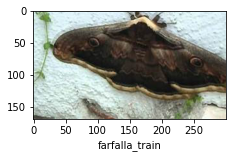

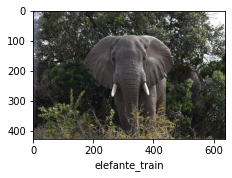

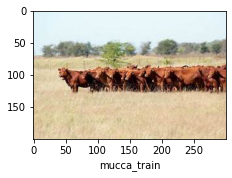

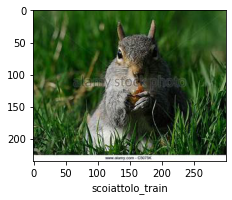

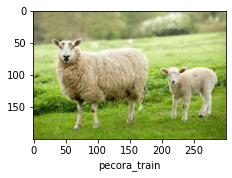

In [7]:
pic_index = 1
for i in range(len(Train_classes)):
  plt.figure(figsize=(20,20))
  plt.subplot(1,5,i+1)
  pics = [os.path.join(dir[i], fname) for fname in names[i][:1]]
  for img_path in pics:  
    img = image.imread(img_path)
    plt.imshow(img)
    plt.xlabel(Train_classes[i])

# Using ImageData generators to load Training and Validation data and Data Augmentation 

# **Task 2: Pre-processing**

Splitting Training Data in Train and Validation Subsets


> Loding Images Using Flow from Directory which applies DataAugmentation Using IMAGEDATAGENERATOR Function (I have rotated the images by 40 Degree ,Shifted images,sheared ,Zoomed and Flipped the images)




In [9]:
Img_size = 32
train_datagen =ImageDataGenerator(rescale = 1./255, # rescaling
                                   rotation_range = 20,  # for augmentation
                                   width_shift_range = 0.2,
                                   validation_split = 0.2,
                                   height_shift_range = 0.2,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True)

#Validation Split is Dividing Train_Data in Train and Validation set
val_datagen = ImageDataGenerator(rescale = 1.0/255.,validation_split = 0.2) 
 
train_generator = train_datagen.flow_from_directory(TRAINING_DIR,
                                                    batch_size = 32,
                                                    subset="training",
                                                    class_mode = 'categorical', 
                                                    target_size = (Img_size, Img_size))
 
validation_generator = val_datagen.flow_from_directory(TRAINING_DIR,
                                                subset = "validation",
                                                    batch_size = 32,
                                                    class_mode = 'categorical', 
                                                    target_size = (Img_size, Img_size))

Found 6558 images belonging to 5 classes.
Found 1638 images belonging to 5 classes.


Each image have different Size so Converting all images of size (320,320) pixels

In [10]:
print("There are ", len(train_generator), "images in the training dataset")     # checking total number of Images / Batch in train_generator
print("There are ", len(validation_generator), "images in the validation dataset")     # checking total number of Images /Batch in Validation Dataset

There are  205 images in the training dataset
There are  52 images in the validation dataset


In [11]:
train_generator.image_shape # Shape of Images inTraining Set

(32, 32, 3)

# TASK 3: Building a Multi-Layer Perceptron , Task 8 with Dropout Layer in Between


In [10]:
def build_mlp(train_generator):
    # Create model architecture
    model = models.Sequential()
    model.add(layers.Dense(128, activation="relu",input_shape=train_generator.image_shape))
    model.add(layers.Dense(256, activation="relu",kernel_regularizer='l2'))
    model.add(layers.Dropout(0.2)) 
    model.add(layers.BatchNormalization())
    model.add(layers.Dense(128, activation="relu")) 
    model.add(layers.Dropout(0.4))
    model.add(layers.Flatten())
    model.add(layers.Dense(64, activation="relu"))


    model.add(layers.Dense(5, activation="softmax"))
    return model

MLP Architecture - build_mlp function is what builds the actual neural network architecture. It receives the data from Train_generator .

Here we have created a Sequential neural network in the first line. Then adding a Flatten layer. Flatten Layer will take input shape from train_generator (Img_size,img_size,3) as Images are in RGB form so it have a 3 Channel.

After that we have some Dense Layers with Dropout in Between .we have used Dense Layer in form of (256,128,64) with each having the activation function (the function that will be performed on the result of multiplying all x-values with their weights, and then adding them up and adding the bias) is the relu function. Relu helps in Getting Rid of any Negative values for Activation as it outputs max(0,X) and kernel Regularizer in first Dense Layer.

Regularizers allow us to apply penalties on layer parameters during optimization. These penalties are summed into the loss function that the network optimizes.
kernel_regularizer: Regularizer to apply a penalty on the layer's kernel
Dropout layer with a parameter of 0.2 and 0.4 shows that an argument will result in a 20% and 40% chance that either neuron will be disregarded from the training in each epoch. This is a counter measure against overfitting 

Batch Normalization Normalize the activations of the previous layer at each batch

Batch normalization differs from other layers in several key aspects: 1) Adding BatchNormalization with training=True to a model causes the result of one example to depend on the contents of all other examples in a minibatch. Be careful when padding batches or masking examples, as these can change the minibatch statistics and affect other examples. 2) Updates to the weights (moving statistics) are based on the forward pass of a model rather than the result of gradient computations. 3) When performing inference using a model containing batch normalization, it is generally (though not always) desirable to use accumulated statistics rather than mini-batch statistics. This is accomplished by passing training=False when calling the model, or using model.predict. Offical Documentation Source

> Indented block



Last Layer is Dense Layer with 5 Nurons as we Have 5 Different Categories in our Training data This Layer Uses Softmax Activation Function.
The “softmax” activation function is a multiclass categorization function.
It will report back the “confidence score” for each class. Since we’re dealing with probabilities here, the scores returned by the softmax function will add up to 1.

In [11]:
model_mlp = build_mlp(train_generator) # Clling the Build Function to Get the Model
model_mlp.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 32, 32, 128)       512       
_________________________________________________________________
dense_1 (Dense)              (None, 32, 32, 256)       33024     
_________________________________________________________________
dropout (Dropout)            (None, 32, 32, 256)       0         
_________________________________________________________________
batch_normalization (BatchNo (None, 32, 32, 256)       1024      
_________________________________________________________________
dense_2 (Dense)              (None, 32, 32, 128)       32896     
_________________________________________________________________
dropout_1 (Dropout)          (None, 32, 32, 128)       0         
_________________________________________________________________
flatten (Flatten)            (None, 131072)            0

Lets Get into the Model Architecture:

*   Our first dense layer had 128 neurons,that means each of the (32,32,3) x-values will get multiplied with 128 weights in a 128 linear functions and adding biases which here it is 128 (because a dense layer is fully connected, so every node in one layer will be connected to every node in the next layer). which will result in 512 parameters.

*   Another dense layer, in which each of the 256 nodes will receive the 128 output x-values (+ a bias) of the previous layer, giving us 256x128 = 33024 trainable parameters +256 bias.

*   Then we have our first dropout layer. That will Randomally drop 20% Neurons.

* Next we have a Batch Normalization Layer which helps in Normalizing out Batches randommaly Selecting Training Data From Batch and Helps in Reducing Regularities.

*   Another dense layer, in which each of the 128 nodes will receive the (32,32,128) output x-values (+ a bias) of the previous layer, giving us 32896  trainable parameters.

*   Then we have our second dropout layer. That will Randomally drop 40% Neurons

*   The flatten layer receives each image as a 32x32x128 matrix, which it flattens to a vector of length 131072. No trainable parameters here, this is getting the image ready for our dense layers.

*   Another dense layer, in which each of the 64 nodes will receive the 128 output x-values (+ a bias) of the previous layer, giving us 64x131072 + 64 bias = 8388672 trainable parameters

*  Finally the Output Layer which gives predict 5 categories .


# TASK 4: Optimizer

In [12]:
# Compile the model
model_mlp.compile(loss="categorical_crossentropy", optimizer=optimizers.RMSprop(lr=2e-5), metrics=["accuracy"])

Compileing the model with the categorical_crossentropy loss function (this is the error function which is used to judge the quality of the model, basically the accuracy of the weights of our equations)

*  Categorical_crossentropy is Used as the Output from the Model is in Categorical Form
*  Learning Rate is 2e-5 which is Found Using GridSearch and provides optimal Learning Rate for the Current Model

*  Optimzer Function After Trying Different Model for Certain Number of Epochs The Most Accurate prediction Result Was Provided by RMSprop .RMSprop provides automatic Hyper Parameter Tuning.


# TASK 5: Training the model

In [13]:
earlystopping_callback = EarlyStopping(
    monitor='val_loss', patience=3, mode='auto', restore_best_weights=True
)
checkpointer_mlp = ModelCheckpoint(filepath = "/content/mlp.hdf5",verbose=0, save_best_only=True)

logdir = os.path.join("logs","MLP")
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

ModelCheckPoint is a handy little utility that you can use to store the weights during the training process. This enables us to load them into our network later.

EarlyStopping is use to monitor the validation loss value to stop the traing process if the validation loss is not decreasing for 3 consicutive Epochs

TensorBoard Callbck is Used for Future Use to visualize the model

In [14]:
model_mlp.fit(train_generator,steps_per_epoch=100,epochs=50 ,validation_data=validation_generator,validation_steps= 52,callbacks=[tensorboard_callback,checkpointer_mlp,earlystopping_callback])

Epoch 1/50
  1/100 [..............................] - ETA: 0s - loss: 3.4504 - accuracy: 0.1562WARNING:tensorflow:From /usr/local/lib/python3.6/dist-packages/tensorflow/python/ops/summary_ops_v2.py:1277: stop (from tensorflow.python.eager.profiler) is deprecated and will be removed after 2020-07-01.
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
100/100 [==============================] - 13s 135ms/step - loss: 3.2109 - accuracy: 0.3341 - val_loss: 3.2106 - val_accuracy: 0.3498
Epoch 2/50
100/100 [==============================] - 13s 133ms/step - loss: 3.0074 - accuracy: 0.4074 - val_loss: 3.1018 - val_accuracy: 0.3950
Epoch 3/50
100/100 [==============================] - 13s 131ms/step - loss: 2.9173 - accuracy: 0.4318 - val_loss: 2.9905 - val_accuracy: 0.4731
Epoch 4/50
100/100 [==============================] - 13s 131ms/step - loss: 2.8577 - accuracy: 0.4272 - val_loss: 2.8610 - val_accuracy: 0.4823
Epoch 5/50
100/100 [==============================] - 13s 

Fit Function takes Lots of Arguments:

* The First Argument is Training_Data Which have Augmented Before

* The Second Argument is Steps_per_epoch which takes the no of Steps for training purpose .This helps in Reducing the memory Requirement.

*   epoch: No of iteration to be performed.

*   validation_data =validation_generator that we want to validate our updated network against and jugde whether model is improving



*   Validation_step is similar to step_per_epoch but it take the Validation Data as Input
*   callbacks: an array with out EarlyStopping and ModelCheckpoint Callback to stop the Traning on given Criteria and and Saving the best model for future usage.

# TASK 6: Tensorboard

Using Tensorboard to display the accuracy and loss graphs of the training. 

In [15]:
%tensorboard --logdir logs/MLP

<IPython.core.display.Javascript object>

Training and validatoin Accuracy are Almost Similar with some Spikes in Validation Accuracy But Even After 49 Epochs Total Accuracy is Not More then 57% 

Validation and Training Loss For MLP Model is Reducing Evenly Without Much Fluctuation.
This Shows Model is Not Over Fitting

# TASK 7: Building a Convolutional Neural Network ,Task 8 with Optimization Techniques

In [78]:
def build_cnn(train_generator):
  model = models.Sequential([
                                    
                                    layers.Conv2D(32, (3,3), activation='relu',input_shape=train_generator.image_shape),
                                    layers.Conv2D(32, (3,3), activation='relu'),
                                    # layers.BatchNormalization(),
                                    layers.MaxPooling2D(2, 2),
                                     layers.Dropout(0.5),
                                    layers.Conv2D(16, (3,3), activation='relu'),
                                    layers.Conv2D(16, (3,3), activation='relu'),
                                    # layers.BatchNormalization(),
                                    layers.MaxPooling2D(2, 2),
                                    layers.Dropout(0.5),
                                    layers.Flatten(),
                             
                                    
                                    layers.Dense(128, activation='relu'),
                                    layers.Dense(64, activation='relu'),        
                                    layers.Dense(5, activation='softmax')])                       
  return model



In [79]:
model_cnn = build_cnn(train_generator)
model_cnn.summary()

Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_48 (Conv2D)           (None, 30, 30, 32)        896       
_________________________________________________________________
conv2d_49 (Conv2D)           (None, 28, 28, 32)        9248      
_________________________________________________________________
max_pooling2d_24 (MaxPooling (None, 14, 14, 32)        0         
_________________________________________________________________
dropout_14 (Dropout)         (None, 14, 14, 32)        0         
_________________________________________________________________
conv2d_50 (Conv2D)           (None, 12, 12, 16)        4624      
_________________________________________________________________
conv2d_51 (Conv2D)           (None, 10, 10, 16)        2320      
_________________________________________________________________
max_pooling2d_25 (MaxPooling (None, 5, 5, 16)        

CNN Model is Made up of Total 13 Layers Lets Break them up 

* First Layer in Convlution2D Layer havin 32 filters of (3,3) size here padding is used to preserve the first and Last row and Column from Getting Ignored Because they dont have all neighbors Activation function is Relu Proiding Same functionality as in MLP .Input_shape Parameter takes input shape of Train_generator.

* Second Layer is Again a Conv2D Layer similar to first Layer 

* Batch Normalization Normalize the activations of the previous layer at each batch
> Batch normalization differs from other layers in several key aspects:
> 1) Adding BatchNormalization with training=True to a model causes the result of one example to depend on the contents of all other examples in a minibatch. Be careful when padding batches or masking examples, as these can change the minibatch statistics and affect other examples.
> 2) Updates to the weights (moving statistics) are based on the forward pass of a model rather than the result of gradient computations.
> 3) When performing inference using a model containing batch normalization, it is generally (though not always) desirable to use accumulated statistics rather than mini-batch statistics. This is accomplished by passing training=False when calling the model, or using model.predict. [Offical Documentation Source](https://www.tensorflow.org/api_docs/python/tf/keras/layers/BatchNormalization)

* Next is Max Pooling Which reduce the Dimenson of Model Half. MaxPooling takes the filter size here (2,2) ,It read the Whole Input and Passes 2X2 filter which selects the maximum value from chosen matrix and passes that to next level.

* Next Four Layers are Similar to first 4 which Conv2D having Filter Size 16

* Ninth Layer is Flatten which Flatten the Input From Previous Layer ( 8, 8, 64) in A Single Matrix of Size 4096(8*8*64) 

* Adding A Dropout Layer to reduce the number of Neurons Here 30% neurons Are Reduced .

* 2 Dense Layer to Make a Fully Connected Network with 128 neurons and Relu Activation Function

* Final Ouput Layer with 5 Categories to Predict and Activation Using Sigmoid Function






Compile the Model CNN

In [80]:
model_cnn.compile(loss = 'categorical_crossentropy', optimizer=optimizers.RMSprop(), metrics=['accuracy'])

All Parameters are same here as Previous MLP Model

Callbacks For CNN

In [81]:
earlystopping_callback = EarlyStopping( monitor='val_loss', patience=5, mode='auto', restore_best_weights=True)

checkpointer_CNN = ModelCheckpoint(filepath = "/content/CNN2.hdf5",verbose=0, save_best_only=True)

logdir = os.path.join("logs","CNN2")
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

Traning For CNN Model


In [82]:
model_cnn.fit(train_generator,steps_per_epoch=100,epochs=50, validation_data=validation_generator,validation_steps= 52,
                   callbacks=[checkpointer_CNN,earlystopping_callback,tensorboard_callback])


Epoch 1/50
100/100 [==============================] - 9s 87ms/step - loss: 1.5856 - accuracy: 0.2484 - val_loss: 1.5168 - val_accuracy: 0.3223
Epoch 2/50
100/100 [==============================] - 8s 84ms/step - loss: 1.4736 - accuracy: 0.3593 - val_loss: 1.3435 - val_accuracy: 0.4475
Epoch 3/50
100/100 [==============================] - 8s 85ms/step - loss: 1.4060 - accuracy: 0.3956 - val_loss: 1.3330 - val_accuracy: 0.4359
Epoch 4/50
100/100 [==============================] - 8s 84ms/step - loss: 1.3623 - accuracy: 0.4284 - val_loss: 1.4009 - val_accuracy: 0.3950
Epoch 5/50
100/100 [==============================] - 8s 85ms/step - loss: 1.3446 - accuracy: 0.4312 - val_loss: 1.1995 - val_accuracy: 0.4786
Epoch 6/50
100/100 [==============================] - 9s 88ms/step - loss: 1.3284 - accuracy: 0.4363 - val_loss: 1.1884 - val_accuracy: 0.5018
Epoch 7/50
100/100 [==============================] - 9s 86ms/step - loss: 1.2942 - accuracy: 0.4681 - val_loss: 1.8347 - val_accuracy: 0.2961

Accuracy and Loss Evaluation

In [85]:
%tensorboard --logdir logs/CNN2

<IPython.core.display.Javascript object>

# TASK 8: Optimization Techniques evaluation only

The Models Defined above Uses Dropout Layer Between Then Lets Evaluate the Performance of Both the Models for Validation Sets

In [86]:
model_cnn.evaluate(validation_generator)

52/52 [==============================] - 2s 37ms/step - loss: 0.9578 - accuracy: 0.6215


[0.9577857851982117, 0.6214896440505981]

In [ ]:
model_mlp.evaluate(validation_generator)

52/52 [==============================] - 2s 47ms/step - loss: 1.6699 - accuracy: 0.5891


[1.6699140071868896, 0.589133083820343]

Even After So Many Epoch both the MLP model And Basic CNN Does not Provide a Sufficient Result .To get A higher Accuracy we can use Pretrained Model using Transfer Learning Which is Shown Below

# **Transfer Learning**

InceptionV3 take Image of Atleast 75,75 so I have Generated Images of 320x320 to Feed in Pretrained Model

In [7]:
Img_size = 320
train_datagen =ImageDataGenerator(rescale = 1./255, # rescaling
                                   rotation_range = 40,  # for augmentation
                                   width_shift_range = 0.2,
                                   validation_split = 0.2,
                                   height_shift_range = 0.2,
                                   shear_range = 0.2,
                                   zoom_range = 0.2,
                                   horizontal_flip = True)

#Validation Split is Dividing Train_Data in Train and Validation set
val_datagen = ImageDataGenerator(rescale = 1.0/255.,validation_split = 0.2) 
 
train_generator = train_datagen.flow_from_directory(TRAINING_DIR,
                                                    batch_size = 32,
                                                    subset="training",
                                                    class_mode = 'categorical', 
                                                    target_size = (Img_size, Img_size))
 
validation_generator = val_datagen.flow_from_directory(TRAINING_DIR,
                                                subset = "validation",
                                                    batch_size = 32,
                                                    class_mode = 'categorical', 
                                                    target_size = (Img_size, Img_size))

Found 6558 images belonging to 5 classes.
Found 1638 images belonging to 5 classes.


Loading Pretrained Model With Their Weights

In [8]:
!wget --no-check-certificate \
    https://storage.googleapis.com/mledu-datasets/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5 \
    -O /tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5
#  
# Create an instance of the inception model from the local pre-trained weights
local_weights_file = '/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5'
 
pre_trained_model = InceptionV3(input_shape = (Img_size, Img_size, 3), 
                                include_top = False)
 
# Make all the layers in the pre-trained model non-trainable
for layer in pre_trained_model.layers:
  layer.trainable = False
  

--2020-09-13 16:47:51--  https://storage.googleapis.com/mledu-datasets/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5
Resolving storage.googleapis.com (storage.googleapis.com)... 74.125.195.128, 173.194.202.128, 74.125.20.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|74.125.195.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 87910968 (84M) [application/x-hdf]
Saving to: ‘/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5’

/tmp/inception_v3_w 100%[===================>]  83.84M   140MB/s    in 0.6s    

2020-09-13 16:47:51 (140 MB/s) - ‘/tmp/inception_v3_weights_tf_dim_ordering_tf_kernels_notop.h5’ saved [87910968/87910968]



Model TransferLearning

In [44]:
def build_TL(pre_trained_model):
  model = models.Sequential()
  model.add(pre_trained_model)
  # Flatten the output layer to 1 dimension
  model.add(layers.Flatten())
  
  model.add(layers.Dense(64, activation='relu'))
  model.add(layers.Dropout(0.4))
  model.add(layers.BatchNormalization())

  # Add a final softmax layer for classification
  model.add(layers.Dense(5, activation='softmax'))
  return model

In [45]:
model_TL = build_TL(pre_trained_model)
model_TL.summary()

Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
inception_v3 (Functional)    (None, 8, 8, 2048)        21802784  
_________________________________________________________________
flatten_7 (Flatten)          (None, 131072)            0         
_________________________________________________________________
dense_14 (Dense)             (None, 64)                8388672   
_________________________________________________________________
dropout_7 (Dropout)          (None, 64)                0         
_________________________________________________________________
batch_normalization_101 (Bat (None, 64)                256       
_________________________________________________________________
dense_15 (Dense)             (None, 5)                 325       
Total params: 30,192,037
Trainable params: 8,389,125
Non-trainable params: 21,802,912
__________________________________

Build_TL function Build the model above Pre_trained Model
Its Architecture is as Follows:


*   Our Model is Sequential ,First Layer in the Model is Pretrained Model 

*   Then We are Flattening our inputs and Converting a 1D Array for Next Layers
*   Third Layer is Dense Layer with 16 neurons and Activation Relu Function

*   Due to This Much Layer Our Model Becomes Very Heavy with 8388672 parameter ,To reduce the number of Neurons We have added Dropout layer with 40% drop


*   Adding Batch Normalizaztion After Dropout
*   Finally we have out Output Layer of 5 Neurons and Sigmoid Activation Function





In [46]:
 model_TL.compile(optimizer =optimizers.RMSprop(3e-3),loss = 'categorical_crossentropy', metrics = ['accuracy'])

In [47]:
earlystopping_callback = EarlyStopping( monitor='val_loss', patience=3, mode='auto', restore_best_weights=True)

checkpointer_TL = ModelCheckpoint(filepath = "/content/TL.hdf5",verbose=0, save_best_only=True)

logdir = os.path.join("logs","TL")
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)

In [48]:
model_TL.fit(
            train_generator,
            steps_per_epoch = 100,
            validation_data = validation_generator,
            epochs = 50,
            verbose = 1,
            validation_steps= 50,
            callbacks=[checkpointer_TL,earlystopping_callback,tensorboard_callback])

Epoch 1/50
100/100 [==============================] - 82s 815ms/step - loss: 0.4234 - accuracy: 0.8581 - val_loss: 0.0834 - val_accuracy: 0.9737
Epoch 2/50
100/100 [==============================] - 79s 793ms/step - loss: 0.2603 - accuracy: 0.9162 - val_loss: 0.0945 - val_accuracy: 0.9688
Epoch 3/50
100/100 [==============================] - 80s 801ms/step - loss: 0.2253 - accuracy: 0.9206 - val_loss: 0.0656 - val_accuracy: 0.9800
Epoch 4/50
100/100 [==============================] - 79s 793ms/step - loss: 0.1909 - accuracy: 0.9375 - val_loss: 0.0748 - val_accuracy: 0.9737
Epoch 5/50
100/100 [==============================] - 79s 791ms/step - loss: 0.1892 - accuracy: 0.9343 - val_loss: 0.0670 - val_accuracy: 0.9787
Epoch 6/50
100/100 [==============================] - 80s 803ms/step - loss: 0.1808 - accuracy: 0.9368 - val_loss: 0.0573 - val_accuracy: 0.9787
Epoch 7/50
100/100 [==============================] - 79s 794ms/step - loss: 0.1654 - accuracy: 0.9415 - val_loss: 0.0759 - val_ac

In [49]:
%tensorboard --logdir logs/TL

<IPython.core.display.Javascript object>

## **Testing Data**

In [50]:
test_dataset = pd.read_csv("/tmp/animal_dataset_intermediate/Testing_set_animals.csv") #Reading Testing_set_animals For Creating Test_dataset

In [51]:
#Converting All testing images in (320,320,3)
def get_data_from_folder(path):
  images = []
  try:
    for f in test_dataset['filename']: 
      img = cv2.imread(path+"/"+f) #read the image
      img = cv2.resize(img,(Img_size,Img_size)) #resize the image
      images.append(np.array(img)/255.0)  #Normalizing The Image
  except :
    pass
  return np.array(images)

In [52]:
test_data = get_data_from_folder(Test_DIR) #Test_Data As Per Submission File

Images From Testing Dataset


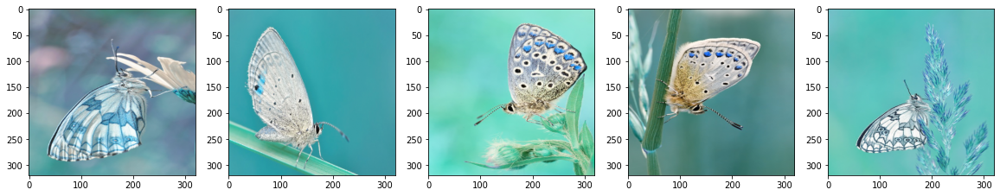

In [53]:
plt.figure(figsize=(20,20))
for i in range(5):
  plt.subplot(1,5,i+1)
  plt.imshow(test_data[i])

# TASK 9: Predict

Model Using Transfer Learning Provides Best Accuracy Among All so using That Model Here is The Prediction for Unseen Test Data

In [54]:
pred = model_TL.predict(test_data)
# Prediction is in float value which is the Probabilty for Each Class Labels


In [55]:
# Labels to Predict as per the Summision File
labels = {0:'elefante', 1:'farfalla', 2:'mucca', 3:'pecora', 4:'scoiattolo'}

# Printing Predicted Values in CSV Format this is an Alternate to Download the Prediction File 
for i in pred:
  print("'"+labels[np.argmax(i)]+"'",end=",")

'farfalla','farfalla','farfalla','farfalla','farfalla','farfalla','elefante','pecora','pecora','pecora','pecora','elefante','elefante','elefante','pecora','farfalla','elefante','elefante','pecora','scoiattolo','elefante','elefante','pecora','pecora','pecora','pecora','elefante','farfalla','farfalla','farfalla','pecora','pecora','pecora','pecora','pecora','elefante','pecora','pecora','pecora','farfalla','farfalla','pecora','farfalla','pecora','pecora','elefante','elefante','elefante','elefante','elefante','elefante','farfalla','farfalla','farfalla','pecora','farfalla','pecora','elefante','farfalla','pecora','pecora','farfalla','farfalla','farfalla','pecora','farfalla','pecora','farfalla','farfalla','pecora','elefante','farfalla','pecora','pecora','pecora','farfalla','elefante','elefante','farfalla','farfalla','farfalla','farfalla','farfalla','elefante','farfalla','farfalla','pecora','elefante','elefante','elefante','farfalla','pecora','elefante','elefante','elefante','mucca','farfalla',

# Visualizing Some of The Predicted Output

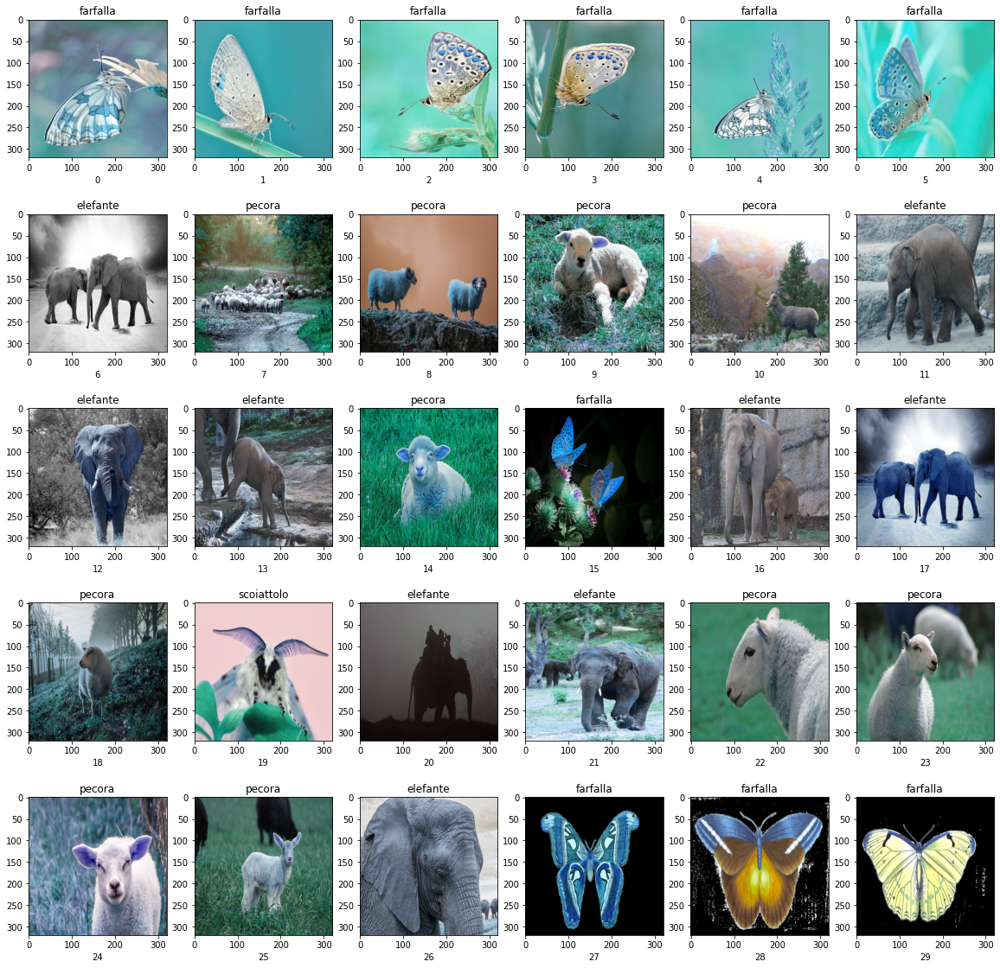

In [56]:
plt.figure(figsize=(20,20))
for i in range(30):
  plt.subplot(5,6,i+1)
  plt.title(labels[(np.argmax(pred[i]))])
  plt.xlabel(i)
  plt.imshow(test_data[i])